In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Загрузка данных Human Brain Cell Atlas v1.0 (https://cellxgene.cziscience.com/collections/283d65eb-dd53-496d-adb7-7570c7caa443)
adata = sc.read('60591892-d938-4cdb-8545-3d84d5c16571.h5ad')

In [3]:
# Read TSV file with PcG genes (https://docs.google.com/spreadsheets/d/1OX1sBCH3fzR3Tg6BkdOtihMl7DHW2uyxMQnYPy-HMzQ/edit?usp=sharing)
polycomb_genes=pd.read_csv('../data/Polycomb_proteins.tsv', sep='\t')

In [4]:
polycomb_genes.head()

,Name,Ensembl_ID,UniprotKB,Other_names,Function,Domain,Complex,Type
0,RING1A,ENSG00000204227,Q06587,RNF1,Ubiquitinates H2AK119,RING finger,PRC1,Core
1,RING1B,ENSG00000121481,Q99496,RNF2,Ubiquitinates H2AK119,RING finger,PRC1,Core
2,CBX2,ENSG00000173894,Q14781,NaN,"Bind H3K27me3, H3K9me3",Chromodomain; AT hook,PRC1,cPRC1
3,CBX4,ENSG00000141582,O00257,NaN,"Bind H3K27me3, H3K9me4",Chromodomain,PRC1,cPRC1
4,CBX6,ENSG00000183741,O95503,NaN,"Bind H3K27me3, H3K9me5",Chromodomain,PRC1,cPRC1


In [5]:
# Cписок генов Polycomb Group Complex: Select Ensembl_ID
genes_of_interest = polycomb_genes['Ensembl_ID'].to_list()

In [6]:
# Filter dataset:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

In [7]:
# Фильтрация данных по интересующим генам:
adata_filtered = adata[:, adata.var_names.isin(genes_of_interest)]

In [8]:
# Проверка наличия генов в данных
print("Гены в данных:", adata_filtered.var_names.to_list())

# Перезаписываем список генов в учётом тех, которые не прошли отбор по качеству:
genes_of_interest = adata_filtered.var_names.to_list()

Гены в данных: ['ENSG00000146285', 'ENSG00000185513', 'ENSG00000156374', 'ENSG00000162521', 'ENSG00000143970', 'ENSG00000143033', 'ENSG00000196233', 'ENSG00000178691', 'ENSG00000139154', 'ENSG00000100395', 'ENSG00000134686', 'ENSG00000180628', 'ENSG00000102098', 'ENSG00000108799', 'ENSG00000168283', 'ENSG00000125952', 'ENSG00000174197', 'ENSG00000173889', 'ENSG00000141431', 'ENSG00000185619', 'ENSG00000198945', 'ENSG00000183741', 'ENSG00000141582', 'ENSG00000163935', 'ENSG00000119403', 'ENSG00000085185', 'ENSG00000277258', 'ENSG00000112511', 'ENSG00000089094', 'ENSG00000008083', 'ENSG00000010803', 'ENSG00000158321', 'ENSG00000111752', 'ENSG00000115289', 'ENSG00000121481', 'ENSG00000112787', 'ENSG00000047634', 'ENSG00000198176', 'ENSG00000156860', 'ENSG00000106462', 'ENSG00000074266', 'ENSG00000171456', 'ENSG00000154655', 'ENSG00000100307', 'ENSG00000102054', 'ENSG00000015153', 'ENSG00000204227', 'ENSG00000273604', 'ENSG00000178177', 'ENSG00000163602', 'ENSG00000169016', 'ENSG0000014157

In [9]:
# Нормализация данных
sc.pp.normalize_total(adata_filtered, target_sum=1e4)
sc.pp.log1p(adata_filtered)

/home/ivan/miniconda3/envs/ML/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/ivan/miniconda3/envs/ML/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


In [10]:
# Получаем матрицу экспрессии и преобразуем в плотный формат, если это разреженная матрица
expression_data = adata_filtered.X.toarray() if hasattr(adata_filtered.X, 'toarray') else adata_filtered.X

In [11]:
# Вычисляем корреляцию
correlation_matrix = np.corrcoef(expression_data.T)

In [12]:
# Преобразование в DataFrame для удобства
correlation_df = pd.DataFrame(correlation_matrix, index=genes_of_interest, columns=genes_of_interest)

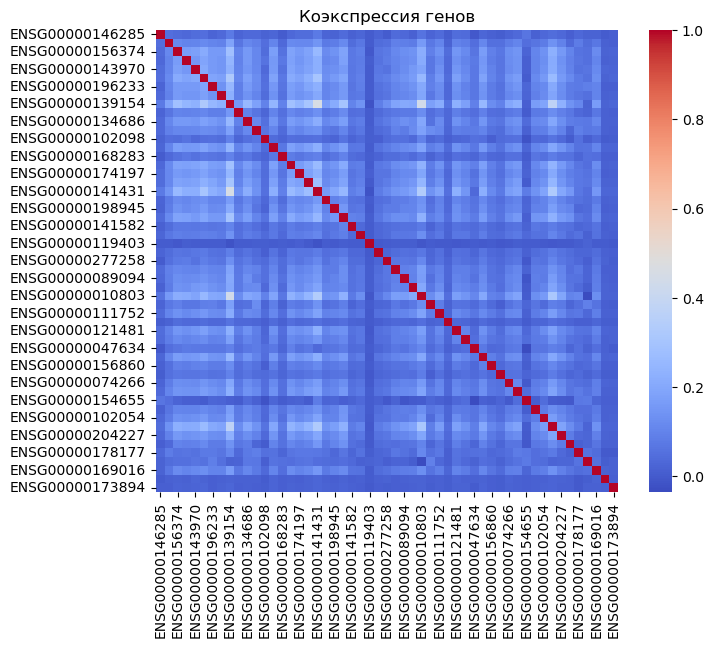

In [13]:
# Визуализация корреляции с использованием seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_df, cmap='coolwarm', annot=False, fmt=".2f", square=True, cbar=True)
plt.title('Коэкспрессия генов')
plt.show()

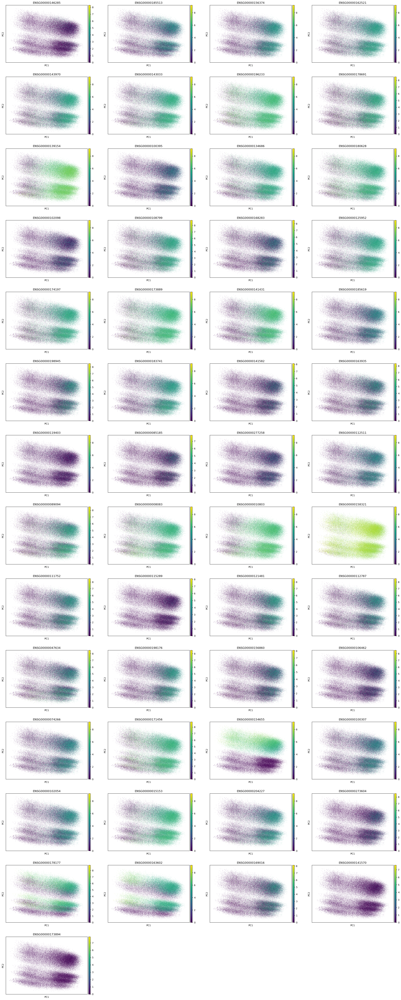

In [14]:
# Дополнительно: можно использовать PCA для визуализации
sc.tl.pca(adata_filtered)
sc.pl.pca(adata_filtered, color=genes_of_interest)

In [15]:
# Выполнение UMAP
sc.pp.neighbors(adata_filtered)  # Вычисляем соседей
sc.tl.umap(adata_filtered)        # Выполняем UMAP

/home/ivan/miniconda3/envs/ML/lib/python3.9/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/home/ivan/miniconda3/envs/ML/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


<Figure size 800x600 with 0 Axes>

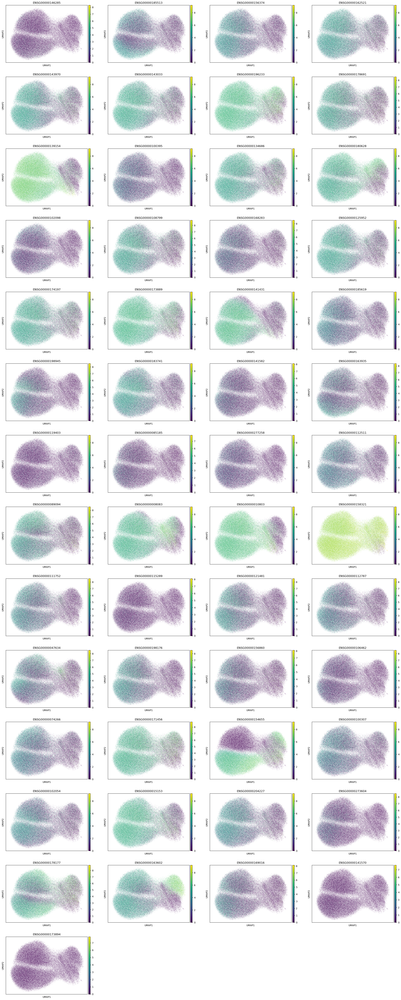

In [16]:
# Визуализация UMAP
plt.figure(figsize=(8, 6))
sc.pl.umap(adata_filtered, color=genes_of_interest, palette='viridis')
plt.show()